<a href="https://colab.research.google.com/github/Abudhagir/3D-Vision/blob/main/VoxNet_3DVSS_2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Deep Learning on Volumetric Representation of 3D Objects**
This notebook implements the paper [VoxNet: A 3D Convolutional Neural Network for real-time object recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=7353481).

## **Getting started**
**Installations, importing necessary packages and downloading the Modelnet10 dataset.**

In [1]:
!pip install trimesh
!pip install open3d
!pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from __future__ import print_function
import os
import sys
import numpy as np
import glob
import re
import torch
from torch.utils.data import Dataset, DataLoader
import argparse
import random
import torch.optim as optim
from torch.utils.data import DataLoader
import torch.nn.functional as F
from tqdm import tqdm
import matplotlib.pyplot as plt
from trimesh.voxel import creation
import trimesh
import open3d as o3d
from collections import OrderedDict
# def blue(x): return '\033[94m' + x + '\033[0m'

In [3]:
!wget http://3dvision.princeton.edu/projects/2014/3DShapeNets/ModelNet10.zip # ModelNet10
!unzip -q ModelNet10.zip;

--2023-05-15 10:27:07--  http://3dvision.princeton.edu/projects/2014/3DShapeNets/ModelNet10.zip
Resolving 3dvision.princeton.edu (3dvision.princeton.edu)... 128.112.136.74
Connecting to 3dvision.princeton.edu (3dvision.princeton.edu)|128.112.136.74|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://3dvision.princeton.edu/projects/2014/3DShapeNets/ModelNet10.zip [following]
--2023-05-15 10:27:07--  https://3dvision.princeton.edu/projects/2014/3DShapeNets/ModelNet10.zip
Connecting to 3dvision.princeton.edu (3dvision.princeton.edu)|128.112.136.74|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 473402300 (451M) [application/zip]
Saving to: ‘ModelNet10.zip’

ModelNet10.zip      100%[===================>] 451.47M   193MB/s    in 2.3s    

2023-05-15 10:27:10 (193 MB/s) - ‘ModelNet10.zip’ saved [473402300/473402300]



In [4]:
!gdown https://drive.google.com/uc?id=1XidXoaltvr4l2oekrZM_eVFtz4DSQNFq # ModelNet10 Voxelized
!unzip -q ModelNet10_voxel.zip;

Downloading...
From: https://drive.google.com/uc?id=1XidXoaltvr4l2oekrZM_eVFtz4DSQNFq
To: /content/ModelNet10_voxel.zip
100% 3.11M/3.11M [00:00<00:00, 65.6MB/s]


### **Setting numpy and torch seed value for reproducibility**

In [5]:
if torch.cuda.is_available():
  if_cuda=True
else:
  if_cuda=False
seed_value=0
np.random.seed(seed_value) # cpu vars
torch.manual_seed(seed_value) # cpu  vars
random.seed(seed_value) # Python
os.environ['PYTHONHASHSEED']=str(seed_value)
if if_cuda: 
    torch.cuda.manual_seed(seed_value)
    torch.cuda.manual_seed_all(seed_value) # gpu vars
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

## **Voxelization of a sample mesh**


In [6]:
root = "./ModelNet10/"
class_name="bathtub"
file_name="bathtub_0001.off"
path=root+class_name+"/train/"+file_name


# Visualizing

scene = trimesh.scene.Scene()
scene.add_geometry(trimesh.load(path))
scene.show()

**We use trimesh library's "voxelize" function to get volumetric reprsentation of our sample mesh.** 
**Here the argument "pitch" is the side length of each voxel.** **Try varing the pitch value and see its effect on the created volumetric shape.**

In [7]:
v = creation.voxelize(trimesh.load(path), pitch=0.5)
v.show()

**We observe that as voxel size increases, we get more abstract geometry of the object. Thus, the origial geometry of the object is not preserved well.**

# **Voxelization of a sample pointcloud**

In [8]:
# Sampling points on the mesh surface

mesh = trimesh.load(path)
sampled_pc = trimesh.sample.sample_surface(mesh, 40000)[0]
p = trimesh.points.PointCloud(sampled_pc, colors=np.tile(np.array([0, 0, 0, 1]), (len(sampled_pc), 1)))
scene = trimesh.scene.Scene()
scene.add_geometry(p)
scene.show()

In [9]:
# Convert point cloud to volumetric representation using open3d

pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(p.vertices)
voxel_grid = o3d.geometry.VoxelGrid.create_from_point_cloud(pcd, voxel_size=0.5)


# Visualizing the voxel grid

voxels=voxel_grid.get_voxels()
vox_mesh=o3d.geometry.TriangleMesh()
for v in voxels:
    cube=o3d.geometry.TriangleMesh.create_box(width=1, height=1, depth=1)
    cube.paint_uniform_color(v.color)
    cube.translate(v.grid_index, relative=False)
    vox_mesh+=cube
mesh = trimesh.Trimesh(vertices=np.array(vox_mesh.vertices),
                       faces=np.array(vox_mesh.triangles))
scene = trimesh.scene.Scene()
scene.add_geometry(mesh)
scene.show()

## **Visualizing Voxelized ModelNet10 Dataset**

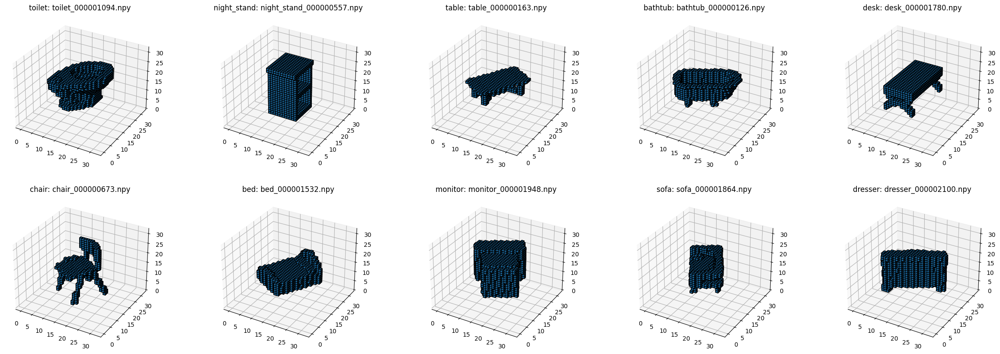

In [10]:
root="ModelNet10_voxel/"
fig=plt.figure(figsize=(30,10))
for idx,cl in enumerate(os.listdir(root)):
  name = os.listdir(os.path.join(root,cl,"train"))[0]
  v_path = os.path.join(root,cl,"train", name)
  ax = fig.add_subplot(2, 5, idx+1, projection='3d')
  p = ax.voxels(np.load(v_path), edgecolor='k')
  ax.set_title(cl+": "+name)


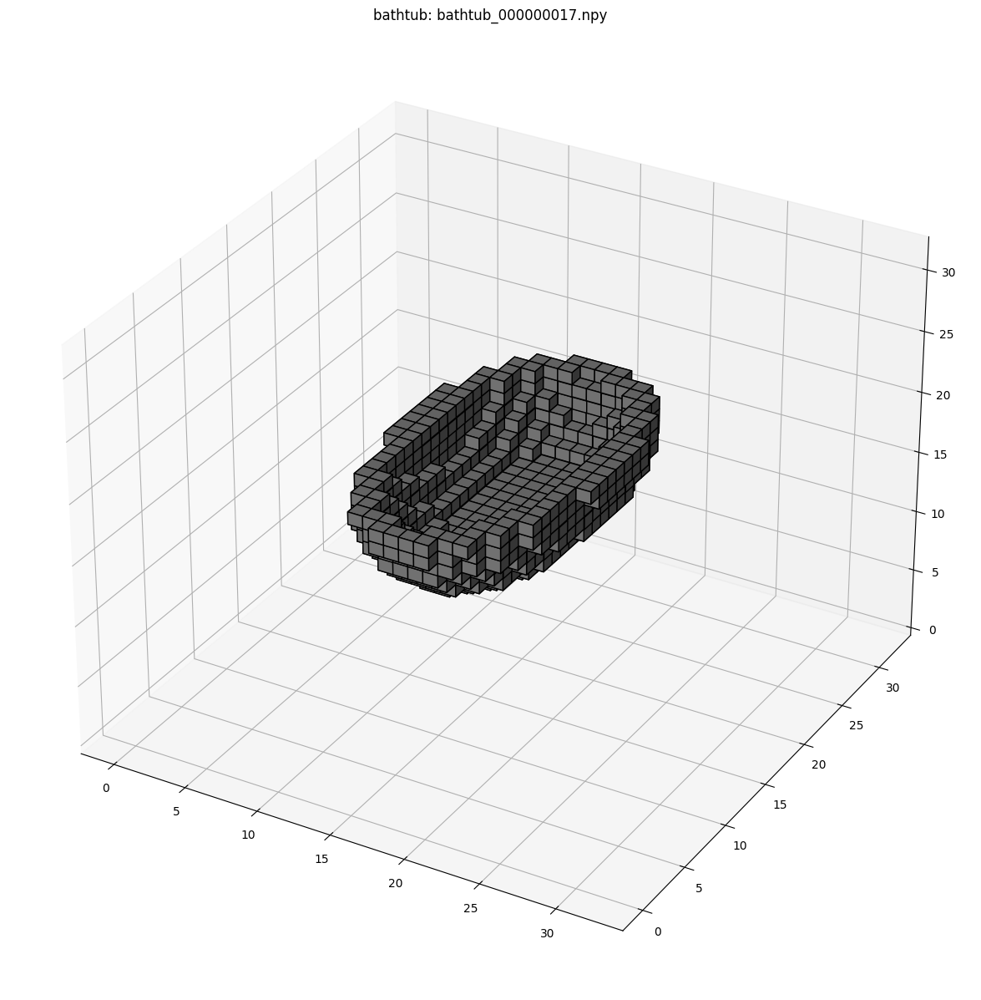

In [11]:
class_name="bathtub"
file="bathtub_000000017.npy"
path=root+class_name+"/train/"

fig=plt.figure(figsize=(15,15))
ax=fig.add_subplot(projection='3d')
ax.voxels(np.load(os.path.join(path,file)), edgecolor='k', facecolors='grey')
ax.set_title(class_name+": "+file)
plt.show()

## **Voxelized ModelNet10 Dataloader**

In [12]:
class ModelNet10Voxel(Dataset):
    def __init__(self, data_root, n_classes, idx2cls, split='train'):
        """
        Args:
            split (str, optional): 'train' or 'test'. Defaults to 'train'.
        """
        self.data_root = data_root
        self.n_classes = n_classes
        self.samples_str = []
        self.cls2idx = {}
        for k, v in idx2cls.items():
            self.cls2idx.update({v: k})
            for sample_str in glob.glob(os.path.join(data_root, v, split, '*.npy')):
                self.samples_str.append(sample_str)

    def __getitem__(self, idx):
        sample_name = self.samples_str[idx]
        cls_name = sample_name.split("/")[-3]
        cls_idx = self.cls2idx[cls_name]
        data = np.load(sample_name)
        data = data[np.newaxis, :]
        sample = {'voxel': data, 'cls_idx': cls_idx}
        return sample

    def __len__(self):
        return len(self.samples_str)

In [13]:
CLASSES = {
    0: 'bathtub',
    1: 'chair',
    2: 'dresser',
    3: 'night_stand',
    4: 'sofa',
    5: 'toilet',
    6: 'bed',
    7: 'desk',
    8: 'monitor',
    9: 'table'
}

data_root = './ModelNet10_voxel'
outf = './voxel_cls'
batchSize = 256
workers =2
epochs=30

In [14]:
train_dataset = ModelNet10Voxel(data_root=data_root, n_classes=len(CLASSES), idx2cls=CLASSES, split='train')
test_dataset = ModelNet10Voxel(data_root=data_root, n_classes=len(CLASSES), idx2cls=CLASSES, split='test')

print("Train dataset size:", len(train_dataset))
print("Test dataset size:", len(test_dataset))

Train dataset size: 3991
Test dataset size: 908


In [15]:
train_dataloader = DataLoader(train_dataset, batch_size=batchSize, shuffle=True, num_workers=int(workers))
test_dataloader = DataLoader(test_dataset, batch_size=batchSize, shuffle=False, num_workers=int(workers))

## **VoxNet Model**

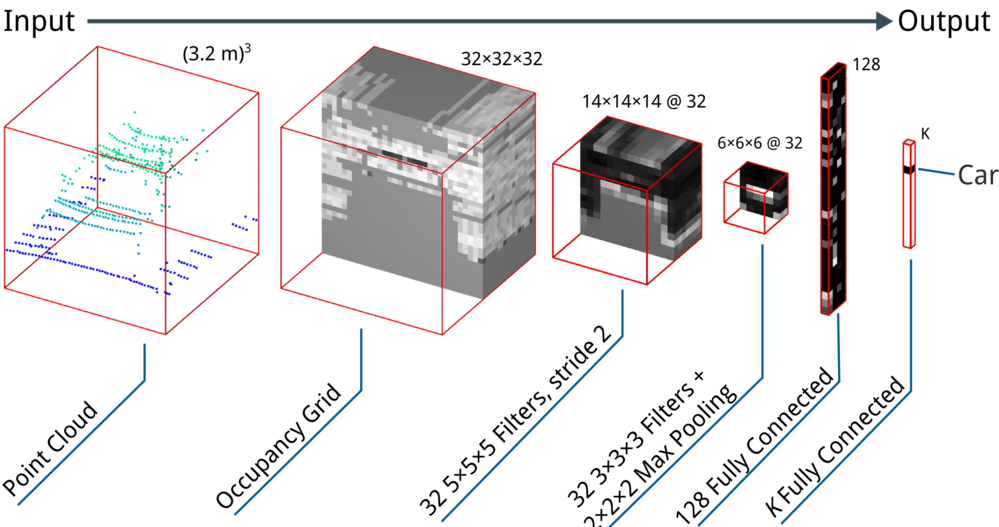

In [16]:
class VoxNet(torch.nn.Module):
    def __init__(self, n_classes=10, input_shape=(32, 32, 32)):
        super(VoxNet, self).__init__()
        self.n_classes = n_classes
        self.input_shape = input_shape
        self.feat = torch.nn.Sequential(OrderedDict([
            ('conv3d_1', torch.nn.Conv3d(in_channels=1,
                                         out_channels=32, kernel_size=5, stride=2)),
            ('relu1', torch.nn.ReLU()),
            ('drop1', torch.nn.Dropout(p=0.2)),
            ('conv3d_2', torch.nn.Conv3d(in_channels=32, out_channels=32, kernel_size=3)),
            ('relu2', torch.nn.ReLU()),
            ('pool2', torch.nn.MaxPool3d(2)),
            ('drop2', torch.nn.Dropout(p=0.3))
        ]))
        x = self.feat(torch.autograd.Variable(torch.rand((1, 1) + input_shape)))
        dim_feat = 1

        for n in x.size()[1:]:
            dim_feat *= n

        self.mlp = torch.nn.Sequential(OrderedDict([
            ('fc1', torch.nn.Linear(dim_feat, 128)),
            ('relu1', torch.nn.ReLU()),
            ('drop3', torch.nn.Dropout(p=0.4)),
            ('fc2', torch.nn.Linear(128, self.n_classes))
        ]))

    def forward(self, x):
        x = self.feat(x)
        x = x.view(x.size(0), -1)
        x = self.mlp(x)
        return x

In [17]:
voxnet = VoxNet(n_classes=len(CLASSES)) #model instance
print(voxnet)
if torch.cuda.is_available():
  voxnet = voxnet.cuda()

optimizer = optim.Adam(voxnet.parameters(), lr=1e-4) #optimizer

VoxNet(
  (feat): Sequential(
    (conv3d_1): Conv3d(1, 32, kernel_size=(5, 5, 5), stride=(2, 2, 2))
    (relu1): ReLU()
    (drop1): Dropout(p=0.2, inplace=False)
    (conv3d_2): Conv3d(32, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1))
    (relu2): ReLU()
    (pool2): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (drop2): Dropout(p=0.3, inplace=False)
  )
  (mlp): Sequential(
    (fc1): Linear(in_features=6912, out_features=128, bias=True)
    (relu1): ReLU()
    (drop3): Dropout(p=0.4, inplace=False)
    (fc2): Linear(in_features=128, out_features=10, bias=True)
  )
)


## **Training Loop**

In [18]:
num_batch = len(train_dataset) // batchSize
best_acc=0
for epoch in range(epochs):
  mean_correct = []
  for i, sample in enumerate(train_dataloader):
    voxel, cls_idx = sample['voxel'], sample['cls_idx']
    if torch.cuda.is_available():
      voxel, cls_idx = voxel.cuda(), cls_idx.cuda()
    voxel = voxel.float()  #torch.Size([batch_size, 1, 32, 32, 32])
    
    optimizer.zero_grad()

    voxnet = voxnet.train()
    pred = voxnet(voxel)  #torch.Size([batch_size, 10])

    loss = F.cross_entropy(pred, cls_idx)
    
    loss.backward()
    optimizer.step()

    pred_choice = pred.data.max(1)[1]
    correct = pred_choice.eq(cls_idx.data).cpu().sum()
    mean_correct.append(correct.item() / float(batchSize))
  print('\n[%d/%d] train loss: %f mean accuracy: %f' %(epoch+1, epochs,loss.item(), np.mean(mean_correct)))
  
  # validation
  with torch.no_grad():
    mean_correct=[]
    for j, sample in enumerate(test_dataloader):
      voxel, cls_idx = sample['voxel'], sample['cls_idx']
      if torch.cuda.is_available():
        voxel, cls_idx = voxel.cuda(), cls_idx.cuda()
      voxel = voxel.float()  #torch.Size([256, 1, 32, 32, 32])
      voxnet = voxnet.eval()
      pred = voxnet(voxel)
      loss = F.nll_loss(pred, cls_idx)
      pred_choice = pred.data.max(1)[1]
      correct = pred_choice.eq(cls_idx.data).cpu().sum()
      mean_correct.append(correct.item() / float(batchSize))
  acc = np.mean(mean_correct)
  print('test [%d], mean accuracy: %f' % (epoch+1, acc))
  
  # saving model having best accuracy
  if acc>=best_acc:
    if not os.path.isdir(outf):
      os.mkdir(outf)
    torch.save(voxnet.state_dict(), '%s/cls_model_%d.pth' % (outf, epoch+1))
    best_acc=acc



[1/30] train loss: 2.097696 mean accuracy: 0.221191
test [1], mean accuracy: 0.185547

[2/30] train loss: 1.659341 mean accuracy: 0.418213
test [2], mean accuracy: 0.422852

[3/30] train loss: 1.275994 mean accuracy: 0.541016
test [3], mean accuracy: 0.508789

[4/30] train loss: 1.134471 mean accuracy: 0.606201
test [4], mean accuracy: 0.547852

[5/30] train loss: 0.843593 mean accuracy: 0.656006
test [5], mean accuracy: 0.579102

[6/30] train loss: 0.803883 mean accuracy: 0.686035
test [6], mean accuracy: 0.616211

[7/30] train loss: 0.837327 mean accuracy: 0.706543
test [7], mean accuracy: 0.608398

[8/30] train loss: 0.799586 mean accuracy: 0.727051
test [8], mean accuracy: 0.643555

[9/30] train loss: 0.786693 mean accuracy: 0.735107
test [9], mean accuracy: 0.642578

[10/30] train loss: 0.643842 mean accuracy: 0.754639
test [10], mean accuracy: 0.663086

[11/30] train loss: 0.677387 mean accuracy: 0.756592
test [11], mean accuracy: 0.667969

[12/30] train loss: 0.623254 mean accu


## **Evaluation on Test set**

In [ ]:
!gdown https://drive.google.com/uc?id=1IPhxjzvG9XkRzOEaB3S-GiSB8Trud4ac

Downloading...
From: https://drive.google.com/uc?id=1IPhxjzvG9XkRzOEaB3S-GiSB8Trud4ac
To: /content/cls_model_30.pth
100% 3.67M/3.67M [00:00<00:00, 197MB/s]


In [21]:
model_name="voxel_cls/cls_model_25.pth"
voxnet.load_state_dict(torch.load(model_name))

<All keys matched successfully>

In [22]:
all_preds = []
all_labels = []

with torch.no_grad():
  mean_correct=[]
  for j, sample in enumerate(test_dataloader):
    voxel, cls_idx = sample['voxel'], sample['cls_idx']
    if torch.cuda.is_available():
      voxel, cls_idx = voxel.cuda(), cls_idx.cuda()
    voxel = voxel.float()  #torch.Size([256, 1, 32, 32, 32])
    voxnet = voxnet.eval()
    pred = voxnet(voxel)
    loss = F.nll_loss(pred, cls_idx)
    pred_choice = pred.data.max(1)[1]
    correct = pred_choice.eq(cls_idx.data).cpu().sum()
    all_preds += list(pred_choice.cpu().numpy())
    all_labels += list(cls_idx.cpu().numpy())
    mean_correct.append(correct.item() / float(batchSize))
acc = np.mean(mean_correct)
print('Test set classification accuracy: %f' % (acc))

Test set classification accuracy: 0.730469


In [23]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(all_labels, all_preds);
cm

array([[33,  0,  0,  0,  6,  0, 10,  0,  0,  1],
       [ 0, 95,  0,  0,  0,  0,  1,  0,  3,  1],
       [ 0,  0, 61, 18,  1,  0,  0,  0,  6,  0],
       [ 0,  0, 17, 63,  0,  1,  0,  2,  1,  2],
       [ 0,  0,  1,  1, 93,  1,  4,  0,  0,  0],
       [ 0,  3,  0,  2,  0, 92,  0,  0,  3,  0],
       [ 2,  1,  0,  0,  2,  0, 94,  0,  0,  1],
       [ 5,  2,  1,  8,  3,  0,  4, 44,  4, 15],
       [ 0,  2,  3,  1,  0,  0,  0,  0, 94,  0],
       [ 0,  0,  0,  1,  0,  0,  0, 20,  0, 79]])

In [24]:
import itertools
# function from https://deeplizard.com/learn/video/0LhiS6yu2qQ
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Normalized confusion matrix


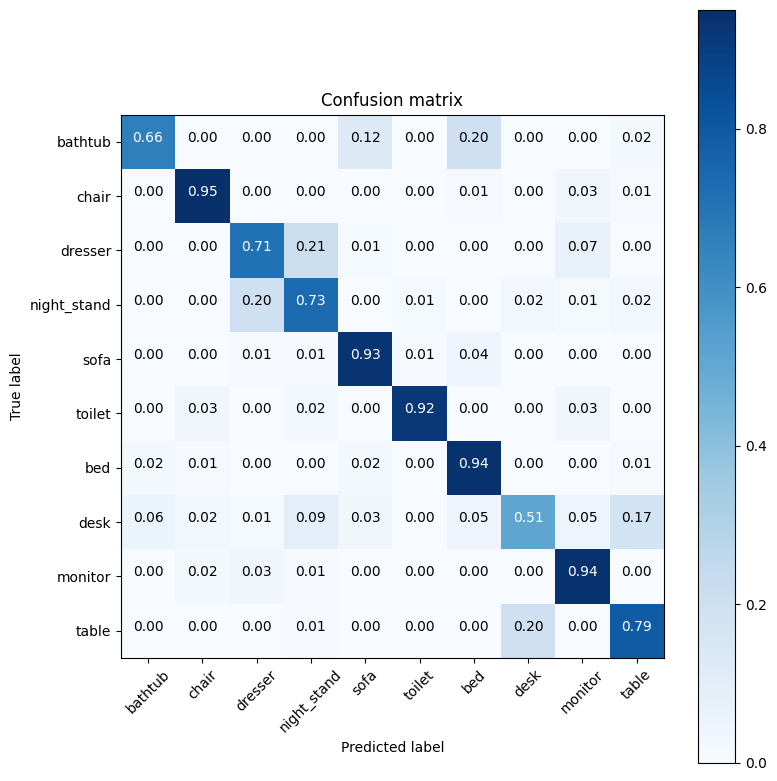

In [25]:
plt.figure(figsize=(8,8))
plot_confusion_matrix(cm, list(CLASSES.values()), normalize=True)

Confusion matrix, without normalization


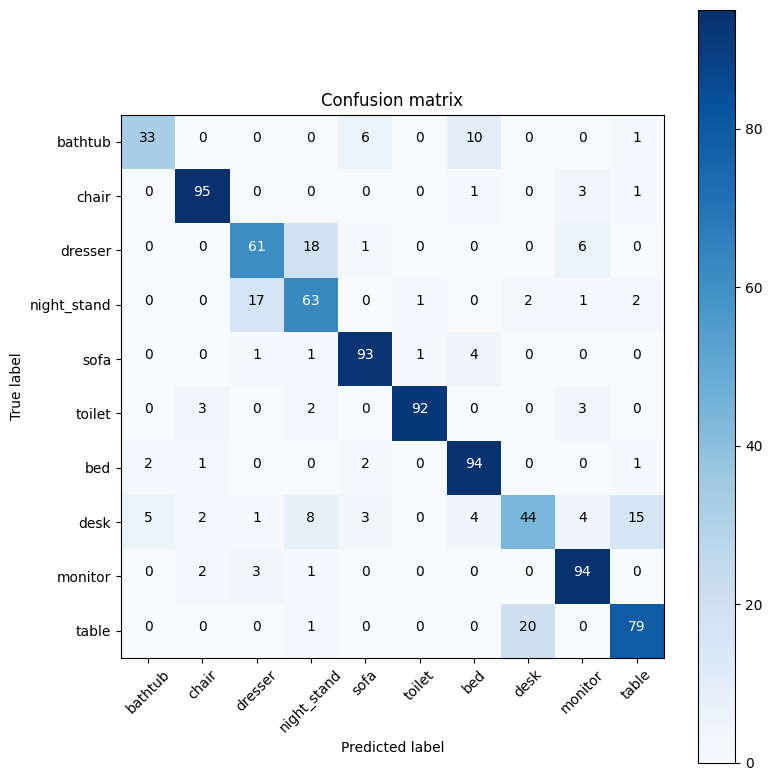

In [26]:
plt.figure(figsize=(8,8))
plot_confusion_matrix(cm, list(CLASSES.values()), normalize=False)